In [1]:
from histoplus.extract import extract
from histoplus.helpers.segmentor import CellViTSegmentor
from histoplus.helpers.tissue_detection import detect_tissue_on_wsi

In [2]:
import os
import openslide

import json
import matplotlib.pyplot as plt
import matplotlib.patches as mpatches
from PIL import Image, ImageDraw, ImageFont
from typing import Dict, Tuple, List

import math
from collections import Counter
from openslide import OpenSlide
from openslide.deepzoom import DeepZoomGenerator


In [50]:
MPP = 0.25  # If available, otherwise set to 0.5
INFERENCE_IMAGE_SIZE = 1568 # default = 784

In [51]:
wsi_path = '/home/nas2_fast/Data/Pathology_project/KBSMC/wsi/1-028_08.svs'
# wsi_path = '/home/sjhong/DB-000037-B2.svs'
os.path.exists(wsi_path)

True

In [52]:
768

406

In [ ]:
slide = openslide.OpenSlide(wsi_path)
slide.dimensions, slide.properties[openslide.PROPERTY_NAME_MPP_X]
tissue_coords, dz_level = detect_tissue_on_wsi(slide)
# 세그멘터 로드(가중치 자동 다운로드; HF 로그인 필요)
for INFERENCE_IMAGE_SIZE in range(406,768, 14):
    segmentor = CellViTSegmentor.from_histoplus(
        mpp=MPP,
        mixed_precision=True,                 # GPU AMP 사용 권장
        inference_image_size=INFERENCE_IMAGE_SIZE,
    )

    # Process a whole slide image
    results = extract(
        slide=slide,
        coords=tissue_coords,
        deepzoom_level=dz_level,
        segmentor=segmentor,
        batch_size= 4, # 786 -> 32
    ) 
    
    #case1 DB-000508-A1: vram 22000mib*3 사용 ram 30g 사용 20min
    #case2 1-028-08: vram 20000mib*3 사용 ram 10~30g 사용 20min / inference 8min[03:21<05:20,  1.73s/it] + 그 외 작업 20분 + filetering
    ### Filter overlapping cells (find-union):  63%|██████▎   | 403843/643120 [00:21<00:11, 20702.95it/s] -> (grouping) 1분? 
    ### Assigning cells to original tiles:  16%|█▌        | 3137/19670 [00:06<00:32, 502.39it/s] 1.5분정도

    output_dir = './output/1_028_08/'
    os.makedirs(output_dir, exist_ok = True)
    json_path = f"{output_dir}/seg_{wsi_path.split('/')[-1][:-4]}_{INFERENCE_IMAGE_SIZE}.json"
    results.save(json_path)
    print(f"OK → {json_path}") # 저장도 오래걸림 case2는 1min 20sec

TIFFReadDirectory: Warning, Unknown field with tag 317 (0x13d) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 317 (0x13d) encountered.
2025-09-22 18:03:30.636 | INFO     | histoplus.helpers.tiling.optimal_mpp:get_tiling_slide_level:149 - 8.3688 is the closest available MPP to the one requested (8.0). Minimal MPP of the slide is 0.261525.
2025-09-22 18:03:30.637 | INFO     | histoplus.helpers.tiling.optimal_mpp:get_tiling_slide_level:149 - 0.52305 is the closest available MPP to the one requested (0.5). Minimal MPP of the slide is 0.261525.
2025-09-22 18:03:35.333 | INFO     | histoplus.helpers.tissue_detection.core:detect_tissue_on_wsi:80 - Found 19670 tiles with Otsu's threshold.
2025-09-22 18:03:48.797 | INFO     | histoplus.helpers.tiling.optimal_mpp:get_tiling_slide_level:149 - 0.261525 is the closest available MPP to the one requested (0.25). Minimal MPP of the slide is 0.261525.


OK → ./output/1_028_08//seg_1-028_08_406.json


2025-09-22 18:29:21.171 | INFO     | histoplus.helpers.tiling.optimal_mpp:get_tiling_slide_level:149 - 0.261525 is the closest available MPP to the one requested (0.25). Minimal MPP of the slide is 0.261525.


OK → ./output/1_028_08//seg_1-028_08_420.json


2025-09-22 18:55:19.351 | INFO     | histoplus.helpers.tiling.optimal_mpp:get_tiling_slide_level:149 - 0.261525 is the closest available MPP to the one requested (0.25). Minimal MPP of the slide is 0.261525.


OK → ./output/1_028_08//seg_1-028_08_434.json


2025-09-22 19:22:42.238 | INFO     | histoplus.helpers.tiling.optimal_mpp:get_tiling_slide_level:149 - 0.261525 is the closest available MPP to the one requested (0.25). Minimal MPP of the slide is 0.261525.


OK → ./output/1_028_08//seg_1-028_08_448.json


2025-09-22 19:50:23.733 | INFO     | histoplus.helpers.tiling.optimal_mpp:get_tiling_slide_level:149 - 0.261525 is the closest available MPP to the one requested (0.25). Minimal MPP of the slide is 0.261525.


OK → ./output/1_028_08//seg_1-028_08_462.json


2025-09-22 20:19:47.726 | INFO     | histoplus.helpers.tiling.optimal_mpp:get_tiling_slide_level:149 - 0.261525 is the closest available MPP to the one requested (0.25). Minimal MPP of the slide is 0.261525.


OK → ./output/1_028_08//seg_1-028_08_476.json


2025-09-22 20:50:24.191 | INFO     | histoplus.helpers.tiling.optimal_mpp:get_tiling_slide_level:149 - 0.261525 is the closest available MPP to the one requested (0.25). Minimal MPP of the slide is 0.261525.


OK → ./output/1_028_08//seg_1-028_08_490.json


2025-09-22 21:22:12.126 | INFO     | histoplus.helpers.tiling.optimal_mpp:get_tiling_slide_level:149 - 0.261525 is the closest available MPP to the one requested (0.25). Minimal MPP of the slide is 0.261525.


OK → ./output/1_028_08//seg_1-028_08_504.json


2025-09-22 21:55:21.504 | INFO     | histoplus.helpers.tiling.optimal_mpp:get_tiling_slide_level:149 - 0.261525 is the closest available MPP to the one requested (0.25). Minimal MPP of the slide is 0.261525.


OK → ./output/1_028_08//seg_1-028_08_518.json


2025-09-22 22:29:39.486 | INFO     | histoplus.helpers.tiling.optimal_mpp:get_tiling_slide_level:149 - 0.261525 is the closest available MPP to the one requested (0.25). Minimal MPP of the slide is 0.261525.


OK → ./output/1_028_08//seg_1-028_08_532.json


2025-09-22 23:05:18.276 | INFO     | histoplus.helpers.tiling.optimal_mpp:get_tiling_slide_level:149 - 0.261525 is the closest available MPP to the one requested (0.25). Minimal MPP of the slide is 0.261525.


OK → ./output/1_028_08//seg_1-028_08_546.json


2025-09-22 23:42:25.708 | INFO     | histoplus.helpers.tiling.optimal_mpp:get_tiling_slide_level:149 - 0.261525 is the closest available MPP to the one requested (0.25). Minimal MPP of the slide is 0.261525.


OK → ./output/1_028_08//seg_1-028_08_560.json


2025-09-23 00:21:34.388 | INFO     | histoplus.helpers.tiling.optimal_mpp:get_tiling_slide_level:149 - 0.261525 is the closest available MPP to the one requested (0.25). Minimal MPP of the slide is 0.261525.


OK → ./output/1_028_08//seg_1-028_08_574.json


2025-09-23 01:03:32.165 | INFO     | histoplus.helpers.tiling.optimal_mpp:get_tiling_slide_level:149 - 0.261525 is the closest available MPP to the one requested (0.25). Minimal MPP of the slide is 0.261525.


OK → ./output/1_028_08//seg_1-028_08_588.json


2025-09-23 01:44:08.896 | INFO     | histoplus.helpers.tiling.optimal_mpp:get_tiling_slide_level:149 - 0.261525 is the closest available MPP to the one requested (0.25). Minimal MPP of the slide is 0.261525.


OK → ./output/1_028_08//seg_1-028_08_602.json


2025-09-23 02:24:47.303 | INFO     | histoplus.helpers.tiling.optimal_mpp:get_tiling_slide_level:149 - 0.261525 is the closest available MPP to the one requested (0.25). Minimal MPP of the slide is 0.261525.


OK → ./output/1_028_08//seg_1-028_08_616.json


2025-09-23 03:04:48.431 | INFO     | histoplus.helpers.tiling.optimal_mpp:get_tiling_slide_level:149 - 0.261525 is the closest available MPP to the one requested (0.25). Minimal MPP of the slide is 0.261525.


OK → ./output/1_028_08//seg_1-028_08_630.json


2025-09-23 03:44:01.442 | INFO     | histoplus.helpers.tiling.optimal_mpp:get_tiling_slide_level:149 - 0.261525 is the closest available MPP to the one requested (0.25). Minimal MPP of the slide is 0.261525.


OK → ./output/1_028_08//seg_1-028_08_644.json


2025-09-23 04:22:34.159 | INFO     | histoplus.helpers.tiling.optimal_mpp:get_tiling_slide_level:149 - 0.261525 is the closest available MPP to the one requested (0.25). Minimal MPP of the slide is 0.261525.


OK → ./output/1_028_08//seg_1-028_08_658.json


2025-09-23 05:01:20.114 | INFO     | histoplus.helpers.tiling.optimal_mpp:get_tiling_slide_level:149 - 0.261525 is the closest available MPP to the one requested (0.25). Minimal MPP of the slide is 0.261525.


OK → ./output/1_028_08//seg_1-028_08_672.json


2025-09-23 05:39:35.492 | INFO     | histoplus.helpers.tiling.optimal_mpp:get_tiling_slide_level:149 - 0.261525 is the closest available MPP to the one requested (0.25). Minimal MPP of the slide is 0.261525.


OK → ./output/1_028_08//seg_1-028_08_686.json


2025-09-23 06:17:55.879 | INFO     | histoplus.helpers.tiling.optimal_mpp:get_tiling_slide_level:149 - 0.261525 is the closest available MPP to the one requested (0.25). Minimal MPP of the slide is 0.261525.


OK → ./output/1_028_08//seg_1-028_08_700.json


2025-09-23 06:55:54.020 | INFO     | histoplus.helpers.tiling.optimal_mpp:get_tiling_slide_level:149 - 0.261525 is the closest available MPP to the one requested (0.25). Minimal MPP of the slide is 0.261525.


OK → ./output/1_028_08//seg_1-028_08_714.json


2025-09-23 07:33:25.902 | INFO     | histoplus.helpers.tiling.optimal_mpp:get_tiling_slide_level:149 - 0.261525 is the closest available MPP to the one requested (0.25). Minimal MPP of the slide is 0.261525.


OK → ./output/1_028_08//seg_1-028_08_728.json


2025-09-23 08:11:12.014 | INFO     | histoplus.helpers.tiling.optimal_mpp:get_tiling_slide_level:149 - 0.261525 is the closest available MPP to the one requested (0.25). Minimal MPP of the slide is 0.261525.


OK → ./output/1_028_08//seg_1-028_08_742.json


2025-09-23 08:49:23.939 | INFO     | histoplus.helpers.tiling.optimal_mpp:get_tiling_slide_level:149 - 0.261525 is the closest available MPP to the one requested (0.25). Minimal MPP of the slide is 0.261525.


OK → ./output/1_028_08//seg_1-028_08_756.json


: 

In [43]:
json_path = './output/KBSMC//seg_1-028_08.json'

In [44]:
with open(json_path, 'r') as f:
    results = json.load(f)

## 데이터 정리

In [6]:
'''
COLOR_MAP_RAW = {
    "Apoptotic Body":   "#fb9a99",  # salmon
    "Cancer cell":      "#a65628",  # brown (RBC의 빨강과 구분)
    "Endothelial Cell": "#1b9e77",  # teal
    "Eosinophils":      "#ff7f00",  # orange
    "Epithelial":       "#1f78b4",  # blue
    "Fibroblasts":      "#dede00",  # yellow
    "Lymphocytes":      "#984ea3",  # purple
    "Macrophages":      "#7570b3",  # indigo
    "Minor Stromal Cell":"#999999", # grey
    "Mitotic Figures":  "#000000",  # black
    "Muscle Cell":      "#66a61e",  # green
    "Neutrophils":      "#f781bf",  # pink
    "Plasmocytes":      "#a6cee3",  # light blue
    "Red blood cell":   "#e41a1c",  # red
}
'''
COLOR_MAP_RAW = {
    "Apoptotic Body":    "#6F4E37",  # 고동색 (짙은 갈색/마룬 톤)
    "Cancer cell":       "#8B0000",  # 검붉은색 (다크 레드)
    "Endothelial Cell":  "#87CEEB",  # 하늘색 (스카이 블루)
    "Eosinophils":       "#ADFF2F",  # 연두색 (그린옐로)
    "Epithelial":        "#FF7F00",  # 주황색 (비비드 오렌지)
    "Fibroblasts":       "#1F3A93",  # 파란색 (진한 로열 블루)
    "Lymphocytes":       "#00BFCF",  # 시안 (청록/사이언)
    "Macrophages":       "#4DAF4A",  # 초록색 (비비드 그린)
    "Minor Stromal Cell":"#C49A6C",  # 옅은 갈색 (라이트 브라운)
    "Mitotic Figures":   "#4B0082",  # 짙은 보라색 (인디고 퍼플)
    "Muscle Cell":       "#003366",  # 남색 (딥 네이비)
    "Neutrophils":       "#FFD700",  # 노란색 (골드/비비드 옐로)
    "Plasmocytes":       "#B19CD9",  # 연보라색 (라벤더)
    "Red blood cell":    "#FF69B4",  # 핫핑크 (핫 핑크)
}
# 혹시 목록에 없는 문자열이 들어오면 쓸 기본색
DEFAULT_COLOR = "#ffffff"

## dz=> openslide 배율 맞추기 

def get_bounds_offset(slide: openslide.OpenSlide):
    bx = int(slide.properties.get(openslide.PROPERTY_NAME_BOUNDS_X, 0) or 0)
    by = int(slide.properties.get(openslide.PROPERTY_NAME_BOUNDS_Y, 0) or 0)
    bw = int(slide.properties.get(openslide.PROPERTY_NAME_BOUNDS_WIDTH, 0) or 0)
    bh = int(slide.properties.get(openslide.PROPERTY_NAME_BOUNDS_HEIGHT, 0) or 0)
    return bx, by, bw, bh

def dz_pixel_to_base(slide, dz, dz_level, x_dz, y_dz):
    W0, H0 = slide.dimensions
    W_dz, H_dz = dz.level_dimensions[dz_level]
    sx = W0 / float(W_dz)
    sy = H0 / float(H_dz)
    bx, by, _, _ = get_bounds_offset(slide)
    x0 = int(round(x_dz * sx)) + bx
    y0 = int(round(y_dz * sy)) + by
    return x0, y0

def dz_tile_to_base(slide, dz, dz_level, tx, ty, tile_size=224, overlap=0):
    step = tile_size - overlap
    x_dz = tx * step
    y_dz = ty * step
    return dz_pixel_to_base(slide, dz, dz_level, x_dz, y_dz)

def dz_tile_base_size(slide, dz, dz_level, tile_size=224, overlap=0):
    step = tile_size - overlap
    W0, H0 = slide.dimensions
    W_dz, H_dz = dz.level_dimensions[dz_level]
    sx = W0 / float(W_dz)
    sy = H0 / float(H_dz)
    w0 = int(round(step * sx))
    h0 = int(round(step * sy))
    return w0, h0

In [7]:
# Histoplus가 쓰는 tile_size=224, overlap=0 가정
dz = DeepZoomGenerator(slide, tile_size=224, overlap=0, limit_bounds=True)


### 특정 영역에서 cell 검출 개수 확인

In [ ]:
# 입력값
x0, y0 = 75500, 45500
W, H = 512, 512  # 확인할 영역 크기(픽셀, level-0 기준)

def point_in_region(x, y, x0, y0, W, H):
    return (x0 <= x < x0+W) and (y0 <= y < y0+H)

hits = []
type_counter = Counter()

# 가정: masks[].coordinates / centroid 는 level-0 절대좌표
# (만약 타일 로컬 좌표라면: abs_x = tile['x'] + coord_x * downsample(level), abs_y 동일)
for tile in results.get("cell_masks", []):
    for m in tile.get("masks", []):
        # 1) 빠른 판정: centroid가 영역 안에 있으면 히트로 간주
        cx, cy = m.get("centroid", [None, None])
        centroid_hit = (cx is not None) and point_in_region(cx, cy, x0, y0, W, H)

        # 2) 보수 판정: 폴리곤 꼭짓점 중 하나라도 영역 안이면 히트
        coords = m.get("coordinates", [])
        vertex_hit = any(point_in_region(x, y, x0, y0, W, H) for x, y in coords)

        if centroid_hit or vertex_hit:
            hits.append(m)
            type_counter[m.get("cell_type", "unknown")] += 1

print(f"검사 영역: x=[{x0},{x0+W}), y=[{y0},{y0+H}) (px, level-0)")
print(f"검출 셀 수: {len(hits)}")
if hits:
    print("유형별 집계:", dict(type_counter))
    # 샘플 몇 개만 보여주기
    for m in hits[:5]:
        print({"cell_id": m.get("cell_id"),
               "cell_type": m.get("cell_type"),
               "confidence": m.get("confidence"),
               "centroid": m.get("centroid")})

### 특정 영역에서 특정 cell class만 개수 확인

In [47]:

x0, y0, W, H = 75500, 45500, 512, 512  # 원하는 영역

def in_region(x, y, x0, y0, W, H):
    return x0 <= x < x0+W and y0 <= y < y0+H

hits = []
for tile in results.get("cell_masks", []):
    for m in tile.get("masks", []):
        ctype = (m.get("cell_type") or "").lower()
        if "cancer" not in ctype.lower() or 'fibroblast' not in ctype.lower():
            continue
        # 중심점으로 빠르게 필터
        cx, cy = m.get("centroid", [None, None])
        centroid_hit = (cx is not None and in_region(cx, cy, x0, y0, W, H))
        # 꼭짓점 중 하나라도 영역에 걸치면 히트로 간주
        vertex_hit = any(in_region(x, y, x0, y0, W, H) for x, y in m.get("coordinates", []))
        if centroid_hit or vertex_hit:
            hits.append({
                "cell_id": m.get("cell_id"),
                "confidence": m.get("confidence"),
                "centroid": m.get("centroid"),
                "type": m.get("cell_type")
            })

print(f"[{x0},{y0},{W},{H}] 영역 Cancer/Fibroblast 포함 셀 수: {len(hits)}")
for h in hits[:10]:  # 샘플 출력
    print(h)


[75500,45500,512,512] 영역 Cancer/Fibroblast 포함 셀 수: 0


### 전체 영역에서 특정 클래스 세포 종류 영역 검색

In [19]:
tiles_with_cancer = []
for t in results.get("cell_masks", []):
    cnt = 0
    for m in t.get("masks", []):
        # if ("cancer" in (m.get("cell_type") or "").lower() or "fibroblast" in (m.get("cell_type") or "").lower()):
        if "neutrophil" in (m.get("cell_type") or "").lower():
            cnt += 1
    if cnt > 1:
        tiles_with_cancer.append({
            "x": t["x"], "y": t["y"], "level": t["level"],
            "width": t["width"], "height": t["height"],
            "count": cnt
        })

print(f"Cancer/Fibroblast 포함 타일 수: {len(tiles_with_cancer)}")
tiles_with_cancer.sort(key=lambda d: int(d.get("count", 0)), reverse=True)
for r in tiles_with_cancer[:10]:
    print(r)

Cancer/Fibroblast 포함 타일 수: 2366
{'x': 190.0, 'y': 66.0, 'level': 16.0, 'width': 224.0, 'height': 224.0, 'count': 64}
{'x': 188.0, 'y': 69.0, 'level': 16.0, 'width': 224.0, 'height': 224.0, 'count': 57}
{'x': 184.0, 'y': 69.0, 'level': 16.0, 'width': 224.0, 'height': 224.0, 'count': 50}
{'x': 165.0, 'y': 73.0, 'level': 16.0, 'width': 224.0, 'height': 224.0, 'count': 48}
{'x': 168.0, 'y': 72.0, 'level': 16.0, 'width': 224.0, 'height': 224.0, 'count': 47}
{'x': 185.0, 'y': 70.0, 'level': 16.0, 'width': 224.0, 'height': 224.0, 'count': 43}
{'x': 118.0, 'y': 72.0, 'level': 16.0, 'width': 224.0, 'height': 224.0, 'count': 43}
{'x': 167.0, 'y': 72.0, 'level': 16.0, 'width': 224.0, 'height': 224.0, 'count': 43}
{'x': 184.0, 'y': 72.0, 'level': 16.0, 'width': 224.0, 'height': 224.0, 'count': 41}
{'x': 164.0, 'y': 74.0, 'level': 16.0, 'width': 224.0, 'height': 224.0, 'count': 41}


### 원본 좌표에서부터 특정 사이즈 타일 검색



In [15]:

def tiles_covering_base_rect(slide, dz, level, x0, y0, w, h,
                             tile_size=224, overlap=0,
                             return_spans=False):
    """
    base(level-0) 사각형(x0,y0,w,h)을 덮는 DZ(level) 타일 범위 빠르게 계산.
    - return_spans=False: [(level, tx, ty), ...] 리스트
    - return_spans=True : [(ty, tx0, tx1), ...] 행 단위 span (더 빠른 순회에 유리)
    """
    # 1) DZ level 해상도 대비 base 배율 + bounds 오프셋
    W0, H0 = slide.dimensions
    Wd, Hd = dz.level_dimensions[level]
    sx, sy = W0 / float(Wd), H0 / float(Hd)  # dz픽셀→base픽셀 배율
    bx, by, _ , _  = get_bounds_offset(slide)

    # 2) base rect → DZ 픽셀 좌표 (오프셋 제거, 배율 반영)
    #    우측/하단 경계는 포함되도록 -eps(=1e-6) 대신 -1 픽셀 후 나눔
    dx0 = (x0 - bx) / sx
    dy0 = (y0 - by) / sy
    dx1 = (x0 + w - 1 - bx) / sx
    dy1 = (y0 + h - 1 - by) / sy

    # 3) DZ 타일 인덱스 범위 (step = tile_size - overlap)
    step = tile_size - overlap
    tx0 = int(math.floor(dx0 / step))
    ty0 = int(math.floor(dy0 / step))
    tx1 = int(math.floor(dx1 / step))
    ty1 = int(math.floor(dy1 / step))

    # 4) 그리드로 클램프
    tiles_w, tiles_h = dz.level_tiles[level]
    tx0 = max(0, min(tx0, tiles_w - 1))
    tx1 = max(0, min(tx1, tiles_w - 1))
    ty0 = max(0, min(ty0, tiles_h - 1))
    ty1 = max(0, min(ty1, tiles_h - 1))

    if return_spans:
        # 행 단위 span으로 반환: (ty, tx0, tx1)
        return [(ty, tx0, tx1) for ty in range(ty0, ty1 + 1)]
    else:
        # 개별 타일 인덱스 나열
        return [(level, tx, ty)
                for ty in range(ty0, ty1 + 1)
                for tx in range(tx0, tx1 + 1)]

# ── 사용 예 ───────────────────────────────────────────────────
lvl = 16
x0, y0 = (73024, 33152)
w, h   = 448, 448

# (A) 낱개 타일 리스트
tiles = tiles_covering_base_rect(slide, dz, lvl, x0, y0, w, h,
                                 tile_size=224, overlap=0, return_spans=False)
if len(tiles) == 1:
    print("I founded this tile:",tiles[0])
    tile = tiles[0]
else:
    print(f"tile count: {len(tiles)}")
    print("first 10:", tiles[:10])  # (level, tx, ty)

'''
    # (B) 행 단위 span (더 빠르게 순회/다운로드)
    spans = tiles_covering_base_rect(slide, dz, lvl, x0, y0, w, h,
                                    tile_size=224, overlap=0, return_spans=True)
    print(f"row spans: {len(spans)} rows")
    print("first 5 spans:", spans[:5])  # (ty, tx0, tx1)
'''
print()

I founded this tile: (16, 163, 74)



## 검색한 tile을 기반으로 해서 시각화하기

###

### 타일들을 검색해두고 하나만 선택하는 경우

In [21]:
tile = tiles_with_cancer[0]

In [110]:
lvl = int(tile['level'])
tx, ty = int(tile['x']), int(tile['y'])

# 1) 타일 좌상단의 base 좌표
x0, y0 = dz_tile_to_base(slide, dz, lvl, tx, ty, tile_size=224, overlap=0)

# 2) 한 칸의 base 폭/높이 (모서리 타일은 실제 더 작을 수도 있음)
w0, h0 = dz_tile_base_size(slide, dz, lvl, tile_size=224, overlap=0)
print((x0, y0), 0, (w0, h0))
# 3) read_region으로 “원본(level-0)”에서 정확한 윈도우 추출
region_base = slide.read_region((x0, y0), 0, (w0, h0)).convert("RGB")
region_base

(73024, 33152) 0 (448, 448)


In [ ]:
tile_masks = []
for t in results.get("cell_masks", []):
    if (
        int(t["x"]) == int(tile["x"]) and
        int(t["y"]) == int(tile["y"]) and
        int(t["level"]) == int(tile["level"]) and
        int(t["width"]) == int(tile["width"]) and
        int(t["height"]) == int(tile["height"])
    ):

print(f"tile_masks 개수: {len(tile_masks)}")
print("샘플:", tile_masks[:2])

### 원하는 타일 하나만 정보를 원하는 경우

In [45]:
for t in results.get("cell_masks", []):
    if (
        int(t["x"]) == int(225) and 
        int(t["y"]) == int(109) and
        int(t["level"]) == int(16)
    ):
        tile_masks = t.get("masks", [])
        print(t)
        break

{'level': 16.0, 'x': 225.0, 'y': 109.0, 'width': 224.0, 'height': 224.0, 'masks': [{'cell_id': 0.0, 'cell_type': 'Lymphocytes', 'confidence': 0.999999995951417, 'coordinates': [[38.0, 0.0], [37.5, 0.5], [37.0, 0.5], [36.5, 1.0], [36.5, 1.5], [35.5, 2.5], [35.5, 7.0], [36.0, 7.5], [36.0, 8.0], [36.5, 8.0], [37.0, 8.5], [39.5, 8.5], [40.0, 8.0], [40.5, 8.0], [42.5, 6.0], [42.5, 5.5], [43.0, 5.0], [43.0, 4.0], [43.5, 3.5], [43.5, 2.0], [43.0, 1.5], [43.0, 1.0], [42.5, 0.5], [42.0, 0.5], [41.5, 0.0]], 'centroid': [39.0, 4.0]}, {'cell_id': 1.0, 'cell_type': 'Cancer cell', 'confidence': 0.999999998019802, 'coordinates': [[48.5, 1.5], [48.0, 2.0], [47.5, 2.0], [46.0, 3.5], [46.0, 5.0], [45.5, 5.5], [45.5, 8.0], [46.0, 8.5], [46.0, 9.0], [46.5, 9.5], [46.5, 10.0], [47.0, 10.5], [47.0, 11.0], [48.0, 12.0], [48.0, 12.5], [49.0, 13.5], [49.5, 13.5], [50.0, 14.0], [51.0, 14.0], [51.5, 14.5], [53.0, 14.5], [53.5, 14.0], [55.0, 14.0], [56.0, 13.0], [56.5, 13.0], [57.5, 12.0], [57.5, 11.0], [58.0, 10

In [16]:
for t in results.get("cell_masks", []):
    if (
        int(t["x"]) == int(tile[1]) and 
        int(t["y"]) == int(tile[2]) and
        int(t["level"]) == int(tile[0])
    ):
        tile_masks = t.get("masks", [])
        
        break
print(t)

{'level': 16.0, 'x': 163.0, 'y': 74.0, 'width': 224.0, 'height': 224.0, 'masks': [{'cell_id': 0.0, 'cell_type': 'Lymphocytes', 'confidence': 0.9785714250765306, 'coordinates': [[201.5, -3.5], [201.0, -3.0], [200.5, -3.0], [199.5, -2.0], [199.5, 1.0], [200.0, 1.5], [200.0, 2.0], [200.5, 2.5], [200.5, 3.0], [201.0, 3.5], [201.0, 4.0], [201.5, 4.5], [201.5, 5.5], [202.0, 6.0], [202.0, 6.5], [202.5, 6.5], [203.0, 7.0], [205.0, 7.0], [206.0, 6.0], [206.0, 3.5], [206.5, 3.0], [206.5, 2.0], [207.0, 1.5], [207.0, -2.5], [206.5, -3.0], [206.5, -3.5]], 'centroid': [203.5, 1.0]}, {'cell_id': 1.0, 'cell_type': 'Neutrophils', 'confidence': 0.999999996031746, 'coordinates': [[23.0, 0.0], [22.5, 0.5], [22.0, 0.5], [22.0, 1.0], [21.5, 1.5], [21.5, 3.0], [22.0, 3.5], [22.0, 4.0], [23.5, 5.5], [24.0, 5.5], [24.5, 6.0], [28.5, 6.0], [29.0, 5.5], [29.5, 5.5], [30.0, 6.0], [30.5, 6.0], [31.0, 5.5], [31.5, 5.5], [33.0, 4.0], [33.0, 3.0], [33.5, 2.5], [33.5, 1.5], [33.0, 1.0], [31.0, 1.0], [30.5, 1.5], [29.0

In [22]:
lvl = int(t['level'])
tx, ty = int(t['x']), int(t['y'])

# 1) 타일 좌상단의 base 좌표
x0, y0 = dz_tile_to_base(slide, dz, lvl, tx, ty, tile_size=224, overlap=0)

# 2) 한 칸의 base 폭/높이 (모서리 타일은 실제 더 작을 수도 있음)
w0, h0 = dz_tile_base_size(slide, dz, lvl, tile_size=224, overlap=0)
print((x0, y0), 0, (w0, h0))
# 3) read_region으로 “원본(level-0)”에서 정확한 윈도우 추출
region_base = slide.read_region((x0, y0), 0, (w0, h0)).convert("RGB")
region_base

(100800, 48832) 0 (448, 448)


In [18]:
# ── 유틸 ─────────────────────────────────────────────
def hex_to_rgb(h):
    h = h.lstrip("#")
    return tuple(int(h[i:i+2], 16) for i in (0, 2, 4))

def load_font(size=14):
    # 가능한 폰트 로드 (환경에 따라 경로 조정)
    try:
        return ImageFont.truetype("DejaVuSans.ttf", size)
    except:
        return ImageFont.load_default()

def draw_label_box(draw, x, y, text, font, bg=(255,255,255,220), fg=(0,0,0), pad=2):
    # 텍스트 배경 박스 + 글자
    bx0, by0, bx1, by1 = draw.textbbox((0,0), text, font=font)
    w, h = bx1 - bx0, by1 - by0
    draw.rectangle([x, y-h-2*pad, x+w+2*pad, y], fill=bg)
    draw.text((x+pad, y-h-pad), text, font=font, fill=fg)

In [46]:
'''
W_dz, H_dz = dz.level_dimensions[lvl]
sx, sy = W0/float(W_dz), H0/float(H_dz)   # dz 픽셀 → base 픽셀 스케일

# 타일 좌상단 base 좌표 (overlap=0 → step=tile_size)
step = int(tile["width"])                  # 보통 224
x0 = int(round(tx * step * sx))
y0 = int(round(ty * step * sy))

# 실제 DZ 타일 크기(가장자리 보정)
img_dz = dz.get_tile(lvl, (tx, ty))        # PIL, dz level의 실제 타일 크기
w0 = int(round(img_dz.width  * sx))
h0 = int(round(img_dz.height * sy))
'''


img_dz = dz.get_tile(lvl, (tx, ty))        # PIL, dz level의 실제 타일 크기

# --- 폴리곤 그릴 때 사용할 스케일: (타일 로컬 → base region 크기) ---
scale_x = w0 / float(img_dz.width)         # 예: 448/224 = 2.0
scale_y = h0 / float(img_dz.height)


region = region_base.copy()
draw = ImageDraw.Draw(region, "RGBA")
# 이 tile에 속한 mask들만 추출

# --- 폴리곤/센트로이드 오버레이 ---
for m in tile_masks:
    ctype = m.get("cell_type")
    color = COLOR_MAP_RAW.get(ctype, DEFAULT_COLOR)

    # 타일 로컬(≈224×224) 좌표 → base region 좌표로 스케일링
    pts = [(x*scale_x, y*scale_y) for (x, y) in m["coordinates"]]
    draw.line(pts + [pts[0]], fill=color, width=2)

    if "centroid" in m:
        cx, cy = m["centroid"]
        cx, cy = cx*scale_x, cy*scale_y
        r = 3
        draw.ellipse([cx-r, cy-r, cx+r, cy+r], outline="white", fill=color)
      

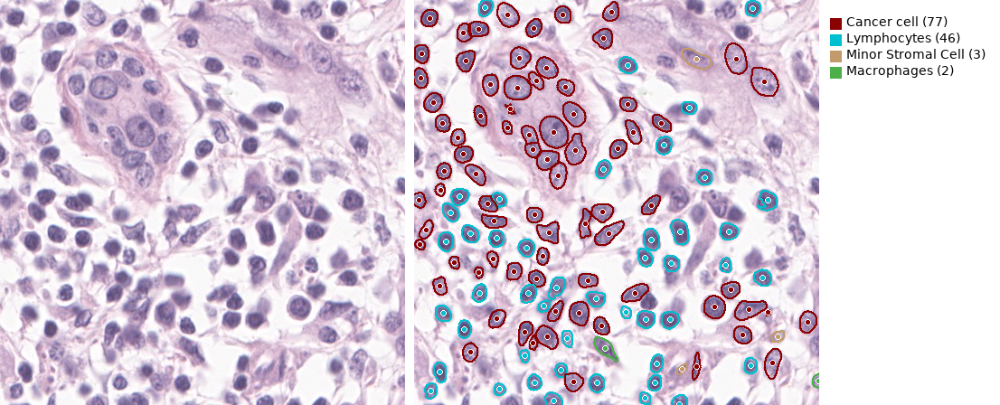

In [47]:
def make_cnt_panel(tile_masks, color_map, width=200, pad=12, lh=18):
    """
    오른쪽 annotation 패널(클래스 목록 + 개수 + 메타정보)
    meta: dict(e.g., {"level": lvl, "tx": tx, "ty": ty, "size": f"{w0}×{h0}"})
    """
    font = load_font(14)
    # 클래스 카운트 (빈도 요약만 패널에 표시; 원한다면 제거해도 됨)
    cnt = Counter((m.get("cell_type") or "unknown").strip() for m in tile_masks)
    rows = sorted(cnt.items(), key=lambda kv: (-kv[1], kv[0]))

    # 패널 높이 계산(헤더/메타 + 클래스 행 수)
    height = pad*2 + lh* (4 + len(rows))
    panel = Image.new("RGB", (width, height), (255,255,255))
    d = ImageDraw.Draw(panel)

    y = pad
    y += 4
    for label, c in rows:
        color = hex_to_rgb(color_map.get(label, DEFAULT_COLOR))
        # 색상 박스
        d.rectangle([pad, y+4, pad+12, y+16], fill=color, outline=None)
        d.text((pad+18, y), f"{label} ({c})", font=font, fill=(0,0,0))
        y += lh

    return panel

def draw_together(region_base, canvas, show_fig = False):
    compare = Image.new("RGB", (region_base.width + canvas.width + 10, region_base.height), (255,255,255))
    compare.paste(region_base, (0, 0))
    compare.paste(canvas, (region_base.width+ 10, 0))
    if show_fig:
        plt.imshow(compare)
    else:
        return compare
    
panel = make_cnt_panel(tile_masks, COLOR_MAP_RAW, width=200)

# 좌측(region) + 우측(panel) 나란히 합치기

H = max(region.height, panel.height)
canvas = Image.new("RGB", (region.width + panel.width, H), (255,255,255))
canvas.paste(region, (0, 0))
canvas.paste(panel, (region.width, 0))
draw_together(region_base, canvas)

In [34]:
import numpy as np 

In [48]:
conf = [x['confidence'] for x in tile_masks]
np.mean(conf)

0.9609580946287679

In [ ]:

def make_count_panel(tile_masks, color_map, info_lines=None, title="Tile annotation",
                     width=200, pad=12, box=12, gap=6, lh=18, font_size=14,
                     show_all=False, sort_by="count"):
    """
    [■] Class name ×count  형식의 패널 생성
    - info_lines: ["x=..","y=..","region=.."] 처럼 자유 텍스트
    - show_all=True면 color_map의 전 클래스 표시(없는 건 ×0)
    - sort_by: "count"(내림차순) | "alpha"
    """
    info_lines = info_lines or []
    font = load_font(font_size)

    # 카운팅 (raw 그대로)
    cnt = Counter((m.get("cell_type") or "unknown").strip() for m in tile_masks)

    # 표시할 클래스 목록
    if show_all:
        classes = list(color_map.keys())
    else:
        present = [lab for lab in cnt.keys() if lab in color_map]
        classes = present

    # 정렬
    if sort_by == "alpha":
        classes = sorted(classes)
    else:
        classes = sorted(classes, key=lambda lab: cnt.get(lab, 0), reverse=True)

    # 패널 높이 대충 계산
    n_lines = (1 if title else 0) + len(info_lines) + len(classes)
    height = pad*2 + n_lines*lh
    panel = Image.new("RGB", (width, height), (255,255,255))
    d = ImageDraw.Draw(panel)

    y = pad
    if title:
        d.text((pad, y), title, font=font, fill=(0,0,0)); y += lh
    for line in info_lines:
        d.text((pad, y), line, font=font, fill=(0,0,0)); y += lh

    # 본문: [■] 이름 ×count
    for lab in classes:
        color = hex_to_rgb(color_map.get(lab, DEFAULT_COLOR))
        top = y + (lh - box)//2
        d.rectangle([pad, top, pad+box, top+box], fill=color)
        d.text((pad + box + 8, y), f"{lab}  ×{cnt.get(lab,0)}", font=font, fill=(0,0,0))
        y += lh

    return panel

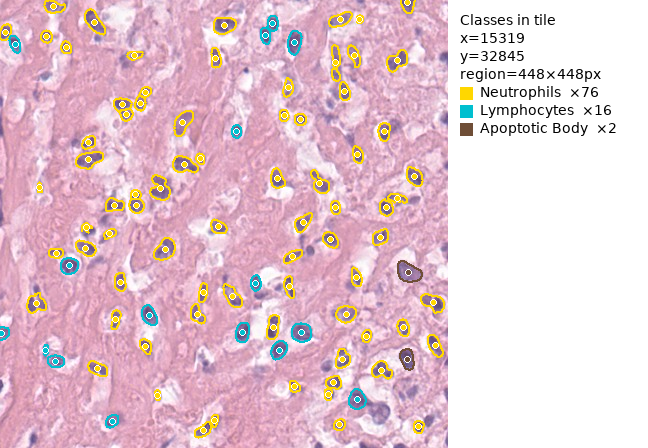

In [144]:
info = [f"x={x0}", f"y={y0}", f"region={region.width}×{region.height}px"]
panel = make_count_panel(tile_masks, COLOR_MAP_RAW, info_lines=info,
                         title="Classes in tile", show_all=False, sort_by="count")

H = max(region.height, panel.height)
canvas = Image.new("RGB", (region.width + panel.width, H), (255,255,255))
canvas.paste(region, (0,0))
canvas.paste(panel, (region.width,0))
canvas  # or canvas.save("tile_with_counts.png")

In [118]:
def make_simple_legend_panel(color_map, classes, title="Legend",
                             width=160, pad=12, box=14, gap=8, font_size=14):
    """[■] Class name 형식의 간단 레전드 패널 이미지 생성"""
    font = _load_font(font_size)
    extra = (box + gap) if title else 0
    height = pad*2 + extra + (box + gap) * len(classes)
    panel = Image.new("RGB", (width, height), (255, 255, 255))
    d = ImageDraw.Draw(panel)

    y = pad
    if title:
        d.text((pad, y-2), title, font=font, fill=(0, 0, 0))
        y += box + gap

    for lab in classes:
        rgb = _hex_to_rgb(color_map.get(lab, DEFAULT_COLOR))
        d.rectangle([pad, y, pad + box, y + box], fill=rgb)
        d.text((pad + box + 8, y - 2), lab, font=font, fill=(0, 0, 0))
        y += box + gap

    return panel

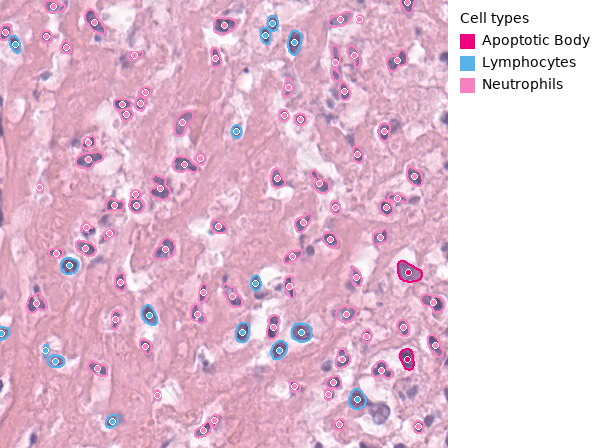

In [119]:
# 1) 타일에 실제로 등장한 클래스만 뽑기 (COLOR_MAP_RAW의 선언 순서 유지)
labels_present = { (m.get("cell_type") or "").strip() for m in tile_masks if m.get("cell_type") }
classes_present = [k for k in COLOR_MAP_RAW.keys() if k in labels_present]

# (옵션) 전체 컬러 인덱스를 항상 보이려면:
SHOW_ALL = False
classes = list(COLOR_MAP_RAW.keys()) if SHOW_ALL else classes_present

# 2) 레전드 패널 생성
panel = make_simple_legend_panel(COLOR_MAP_RAW, classes, title="Cell types")

# 3) 좌측 이미지 + 우측 레전드 합치기
H = max(region_base.height, panel.height)
canvas = Image.new("RGB", (region.width + panel.width, H), (255,255,255))
canvas.paste(region, (0, 0))
canvas.paste(panel, (region.width, 0))

canvas  # Jupyter면 바로 표시; 파일 저장은 canvas.save("overlay_with_legend.png")

In [120]:
def make_simple_panel(tile_masks, color_map, info_lines=None,
                      title="Legend", width=220, pad=12, box=12, gap=6, lh=18, font_size=14,
                      show_all=False):
    """
    - info_lines: ["x=...", "y=...", "region=..."] 처럼 임의 문자열 리스트
    - show_all=False면 타일에 실제로 등장한 class만 표시
    """
    info_lines = info_lines or []
    font = _load_font(font_size)

    # 타일에 등장한 클래스만(또는 전체) 선택
    present = { (m.get("cell_type") or "").strip() for m in tile_masks if m.get("cell_type") }
    classes = list(color_map.keys()) if show_all else [k for k in color_map.keys() if k in present]

    # 패널 높이 계산(대략)
    n_lines = (1 if title else 0) + len(info_lines) + len(classes)
    height = pad*2 + n_lines*lh
    panel = Image.new("RGB", (width, height), (255,255,255))
    d = ImageDraw.Draw(panel)

    y = pad
    if title:
        d.text((pad, y), title, font=font, fill=(0,0,0)); y += lh
    for line in info_lines:
        d.text((pad, y), line, font=font, fill=(0,0,0)); y += lh

    for lab in classes:
        rgb = _hex_to_rgb(color_map.get(lab, "#cccccc"))
        # [■] box
        top = y + (lh - box)//2
        d.rectangle([pad, top, pad+box, top+box], fill=rgb)
        d.text((pad + box + 8, y), lab, font=font, fill=(0,0,0))
        y += lh

    return panel

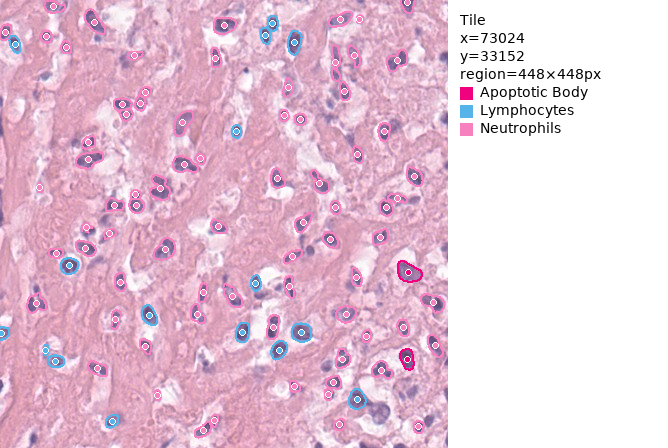

In [121]:
# region: 이미 448x448에 폴리곤 그려둔 이미지
# tile_masks: 해당 타일의 마스크
# COLOR_MAP_RAW: 너가 만든 raw 컬러맵

info = [f"x={x0}", f"y={y0}", f"region={region.width}×{region.height}px"]
panel = make_simple_panel(tile_masks, COLOR_MAP_RAW, info_lines=info, title="Tile")

H = max(region.height, panel.height)
canvas = Image.new("RGB", (region.width + panel.width, H), (255,255,255))
canvas.paste(region, (0,0))
canvas.paste(panel, (region.width,0))

canvas  # .save("out.png") 해도 OK


In [122]:
def make_side_panel(tile_masks, color_map, meta, width=280, pad=12, lh=18):
    """
    오른쪽 annotation 패널(클래스 목록 + 개수 + 메타정보)
    meta: dict(e.g., {"level": lvl, "tx": tx, "ty": ty, "size": f"{w0}×{h0}"})
    """
    font = load_font(14)
    # 클래스 카운트 (빈도 요약만 패널에 표시; 원한다면 제거해도 됨)
    cnt = Counter((m.get("cell_type") or "unknown").strip() for m in tile_masks)
    rows = sorted(cnt.items(), key=lambda kv: (-kv[1], kv[0]))

    # 패널 높이 계산(헤더/메타 + 클래스 행 수)
    height = pad*2 + lh* (4 + len(rows))
    panel = Image.new("RGB", (width, height), (255,255,255))
    d = ImageDraw.Draw(panel)

    y = pad
    d.text((pad, y), "Tile annotation", font=font, fill=(0,0,0)); y += lh
    d.text((pad, y), f"level={meta.get('level')}  (tx,ty)=({meta.get('tx')},{meta.get('ty')})", font=font, fill=(0,0,0)); y += lh
    d.text((pad, y), f"region={meta.get('size')}", font=font, fill=(0,0,0)); y += lh
    y += 4

    d.text((pad, y), "Classes in tile:", font=font, fill=(0,0,0)); y += lh
    for label, c in rows:
        color = hex_to_rgb(color_map.get(label, DEFAULT_COLOR))
        # 색상 박스
        d.rectangle([pad, y+4, pad+12, y+16], fill=color, outline=None)
        d.text((pad+18, y), f"{label}  ×{c}", font=font, fill=(0,0,0))
        y += lh

    return panel


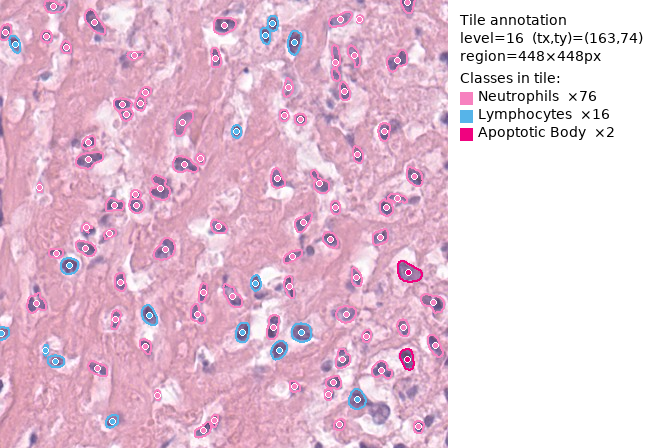

In [123]:
meta = {"level": lvl, "tx": tx, "ty": ty, "size": f"{Wb}×{Hb}px"}
panel = make_side_panel(tile_masks, COLOR_MAP_RAW, meta, width=200)

# 좌측(region) + 우측(panel) 나란히 합치기
H = max(region.height, panel.height)
canvas = Image.new("RGB", (region.width + panel.width, H), (255,255,255))
canvas.paste(region, (0, 0))
canvas.paste(panel, (region.width, 0))

canvas

In [ ]:
COLOR_MAP_RAW = {
    "Apoptotic Body":   "고동색",  # vivid magenta
    "Cancer cell":      "검붉은색",  # brown
    "Endothelial Cell": "하늘색",  # teal
    "Eosinophils":      "연두색",  # orange
    "Epithelial":       "주황색",  # blue
    "Fibroblasts":      "파란색",  # yellow
    "Lymphocytes":      "시안",  # sky blue
    "Macrophages":      "초록색",  # purple
    "Minor Stromal Cell":"옅은 갈색", # grey
    "Mitotic Figures":  "짙은 보라색",  # black
    "Muscle Cell":      "?",  # green
    "Neutrophils":      "노란색",  # pink
    "Plasmocytes":      "?",  # red
    "Red blood cell":   "핫핑크",  # dark red
}

In [ ]:
region_small = region_base.copy().resize((224,224))
draw = ImageDraw.Draw(region, "RGBA")
# 이 tile에 속한 mask들만 추출

for m in tile_masks:  # tile_masks = tile["masks"]
    ctype_norm = str(m.get("cell_type"))
    color = COLOR_MAP_RAW.get(ctype_norm, DEFAULT_COLOR)

    # 1) polygon 좌표 그대로 사용 (이미 타일 로컬)
    coords_local = [(x, y) for x, y in m["coordinates"]]

    # 2) polygon 그리기
    draw.line(coords_local + [coords_local[0]], fill=color, width=2)

    # 3) centroid 점 찍기
    cx, cy = m["centroid"]
    r = 2
    draw.ellipse([cx-r, cy-r, cx+r, cy+r], outline="white", fill=color)

region_small